# FastForman - An efficient Forman-Ricci Curvature computation for higher-order faces in Simplicial Complexes

 Here, we provide a set-theoretical Python coding for efficiently computing Forman-Ricci Curvature (FRC) for simplicial complexes.

This code development was based on our work on [1]. A benchmark comparison with other Python algorithms in the literature for computing FRC can be found in [2].

## Content:

- `fastforman.pyx`
- `compyler.py`
- `setup.py`
- `Example.ipynb`

## Python version: 
    3.8.5
## Package requirement:

- `numpy==1.23.0`
- `networkx==2.6.3`
- `gudhi==3.5.0`
- `cython==0.29.21`
- `distutils==3.8.5`


## Installation:
To this purpose, the user will need to compile the file `compiler.py` in cython by running the command:

```python
python3 compiler.py build_ext --inplace
```

After successful compilation, the generated `fastforman` file can be imported as a package, for instance:

```python
import fastforman as ff
```
## Functions:
- ``compute_average_FRC``:

    ***Input:*** The input parameters can be in two ways:
        
    - `Tuple, max_dim`, where  `Tuple=(D,Thres)` is a tuple containing a dictionary of points (the keys are the points enumeration and the values are the n-dimensional points coordinates) and the distance threshold,`Thres`,  and `(D,max_dim)` is the maximum face dimension, `max_dim`;
    
    - `G, max_dim`, where `G` is a simple undirected network graph, and is `max_dim` the maximum dimension.
    
    
***Output:*** A dictionary in which the keys are the dimension and the values are the average FRC for fixed dimension.
    
    
- ``compute_FRC_frequency``:

    ***Input:*** Same as in `compute_average_FRC`.
    ***Output:*** A dictionary in which the keys are the dimension and the values is a dictionary of the frequency of FRC values.
    
Below, we provide some examples.

## Contact and Support:

danillo.dbs16@gmail.com, dbarros@bcamath.org

## References: 

If you appreciate our work, please, cite us:
[1] Efficient set-theoretic algorithms for computing high-order Forman-Ricci curvature on abstract simplicial complexes; Barros de Souza, Danillo; da Cunha, Jontatas, A.N. Santos, Fernando; Jost, Juergen & Rodigues, Serafim; Link: https://arxiv.org/html/2308.11763v4

[2] Forman-Ricci curvature Benchmark report, Kaggle repository, Link: https://www.kaggle.com/datasets/danillosouza2020/forman-ricci-curvature-benchmark-report

## Importing Packages for the data visualization:

In [1]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from scipy.spatial.distance import pdist, squareform
from random import shuffle
import numpy as np
import pandas as pd

### Examples:

Importing ***fastforman*** after compilation:

In [2]:
import fastforman as ff

# Example 1: Computing FRC from point cloud data:

Defining functions for generating 3D point cloud data on Sphere, Torus ans Möbius strip and cube, respectively:

In [9]:
def gen_torus_point(a,c):
    u,v=2*np.pi*np.random.uniform(0,1,2)
    x=(c+a*np.cos(v))*np.cos(u)
    y=(c+a*np.cos(v))*np.sin(u)
    z=a*np.sin(v)
    return (x,y,z)

In [10]:
def gen_mobius_point(r,s):
    t=2*np.pi*np.random.uniform(-1,1)
    x=(r+s*np.cos(0.5*t))*np.cos(t)
    y=(r+s*np.cos(0.5*t))*np.sin(t)
    z=s*np.sin(0.5*t)
    return (x,y,z)

In [11]:
def gen_cube_point(d):
    extremes=[-d,d]
    x=np.random.uniform(-d,d)
    y=np.random.uniform(-d,d)
    point=[x,y,extremes[np.random.randint(2)]]
    shuffle(point)
    return point
    

Defining function to visualize those points:

In [12]:
def plot3DPoints(points,threshold,title):
  


    data=pd.DataFrame()

    data["X"]=[i[0] for i in points]
    data["Y"]=[i[1] for i in points]
    data["Z"]=[i[2] for i in points]


    # Calculate pairwise distances
    distances = squareform(pdist(data[['X', 'Y', 'Z']]))


    # Create edge list based on threshold
    edges = []
    for i in range(len(data)):
        for j in range(i+1, len(data)):
            if distances[i, j] <= threshold:
                edges.append((i, j))

    # Create scatter plot
    fig = go.Figure()

    # Add scatter plot for points
    fig.add_trace(go.Scatter3d(
        x=data['X'],
        y=data['Y'],
        z=data['Z'],
        mode='markers',
        marker=dict(
            size=5,
            color='blue',
            opacity=0.5
        ),
        name='Points'
    ))

    # Add scatter plot for edges
    edge_x = []
    edge_y = []
    edge_z = []
    for edge in edges:
        edge_x.extend([data['X'][edge[0]], data['X'][edge[1]], None])
        edge_y.extend([data['Y'][edge[0]], data['Y'][edge[1]], None])
        edge_z.extend([data['Z'][edge[0]], data['Z'][edge[1]], None])

    fig.add_trace(go.Scatter3d(
        x=edge_x,
        y=edge_y,
        z=edge_z,
        mode='lines',
        line=dict(color='red', width=2),
        name='Edges'
    ))
    fig.update_layout(
        title=title
    )
        # Show plot
    fig.show()
    return fig

    

<module 'numpy' from '/Users/danillosouza/opt/anaconda3/lib/python3.8/site-packages/numpy/__init__.py'>

In [18]:
from plotly.offline import plot

In [19]:
plot(Fig, filename='plotly_graph.html')

'plotly_graph.html'

In [17]:
Fig=plot3DPoints(cube_points,1,"Test")

Importing Packages:

In [92]:
import numpy as np
import gudhi as gd
from itertools import combinations

Importing Packages for the data visualization:

In [14]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from scipy.spatial.distance import pdist, squareform

Generating sets of 1000 points each:

In [15]:
torus_points=[gen_torus_point(1,2) for i in range(1000)]
sphere_points=[gen_torus_point(2,0) for i in range(1000)]
mobius_points=[gen_mobius_point(3,np.random.uniform(0.,2)) for i in range(1000)]
cube_points=[gen_cube_point(1) for i in range(1000)]

Setting the threshold distance between points:

In [65]:
Threshold=0.5

Ploting points:

In [89]:
plot3DPoints(sphere_points,Threshold,"Random 3D-Sphere points - Threshold: "+str(Threshold))
plot3DPoints(torus_points,Threshold,"Random 3D-Torus points - Threshold: "+str(Threshold))

In [90]:
plot3DPoints(mobius_points,Threshold,"Random 3D-Mobius Strip points - Threshold: "+str(Threshold))
plot3DPoints(cube_points,Threshold,"Random 3D-Cube points - Threshold: "+str(Threshold))

Generating random 1000 points in the torus, sphere, Mobius strip and cube, respectively:

In [67]:
torus_points=[gen_torus_point(1,2) for i in range(1000)]
sphere_points=[gen_torus_point(2,0) for i in range(1000)]
mobius_points=[gen_mobius_point(3,np.random.uniform(0.,2)) for i in range(1000)]
cube_points=[gen_cube_point(1) for i in range(1000)]

Creating dictionary of those points:

In [68]:
Sphere={i:sphere_points[i] for i in range(len(sphere_points))}
Torus={i:torus_points[i] for i in range(len(torus_points))}
Mobius={i:mobius_points[i] for i in range(len(mobius_points))}
Cube={i:cube_points[i] for i in range(len(mobius_points))}

Computing FRC for the Sphere: 

In [69]:
Frec_Sphere=ff.compute_FRC_frequency((Sphere,Threshold),3)

(-100.0, 100.0)

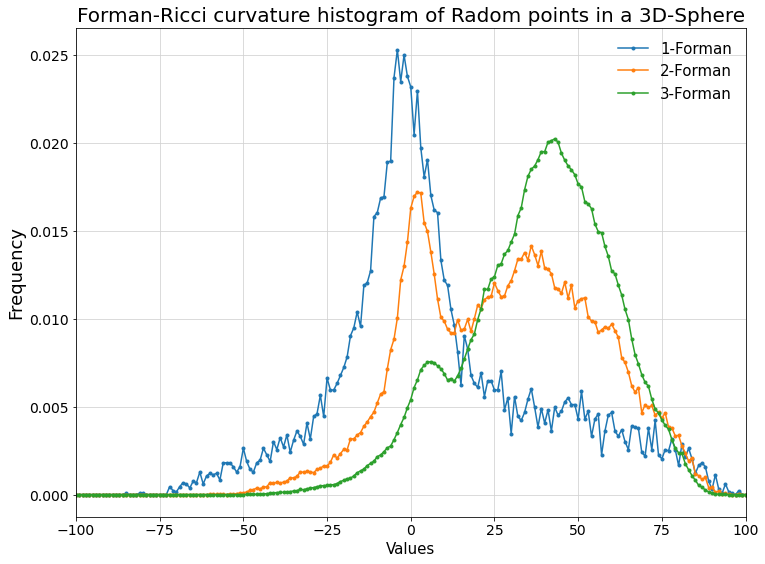

In [189]:
plt.figure(figsize=(12,9))
for d in Frec_Sphere.keys():
    Prob=np.array(list(Frec_Sphere[d].values()))
    Prob=Prob/sum(Prob)
    plt.plot(list(Frec_Sphere[d].keys()),Prob,marker=".",label=str(d)+"-Forman")
plt.legend(framealpha=0,fontsize=15)
plt.title("Forman-Ricci curvature histogram of Radom points in a 3D-Sphere", fontsize=20)
plt.xlabel("Values",fontsize=15)
plt.ylabel("Frequency",fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(color="lightgray")
plt.xlim(-100,100)

Computing FRC for the torus:

In [71]:
Frec_Torus=ff.compute_FRC_frequency((Torus,Threshold),3)

(-100.0, 100.0)

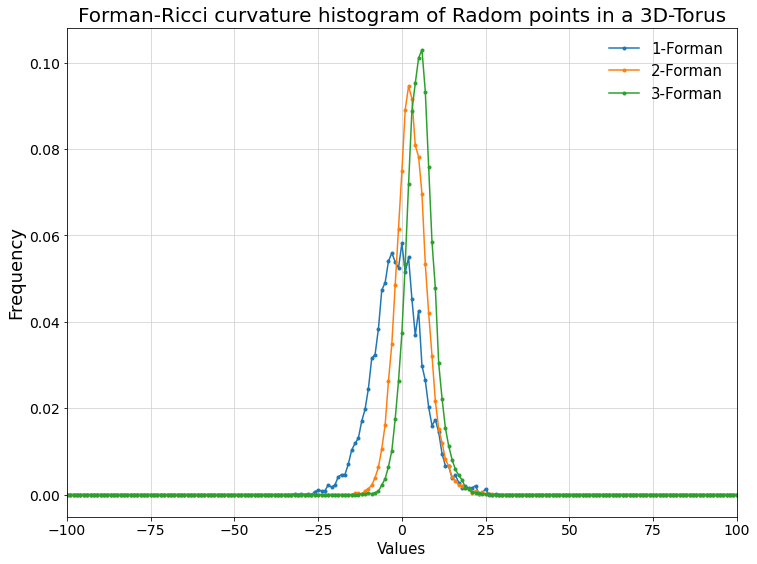

In [187]:
plt.figure(figsize=(12,9))
for d in Frec_Torus.keys():
    Prob=np.array(list(Frec_Torus[d].values()))
    Prob=Prob/sum(Prob)
    plt.plot(list(Frec_Torus[d].keys()),Prob,marker=".",label=str(d)+"-Forman")
plt.legend(framealpha=0,fontsize=15)
plt.title("Forman-Ricci curvature histogram of Radom points in a 3D-Torus", fontsize=20)
plt.xlabel("Values",fontsize=15)
plt.ylabel("Frequency",fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(color="lightgray")
plt.xlim(-100,100)

Computing FRC for the Mobius strip:

In [73]:
Frec_Mobius=ff.compute_FRC_frequency((Mobius,Threshold),3)

(-100.0, 100.0)

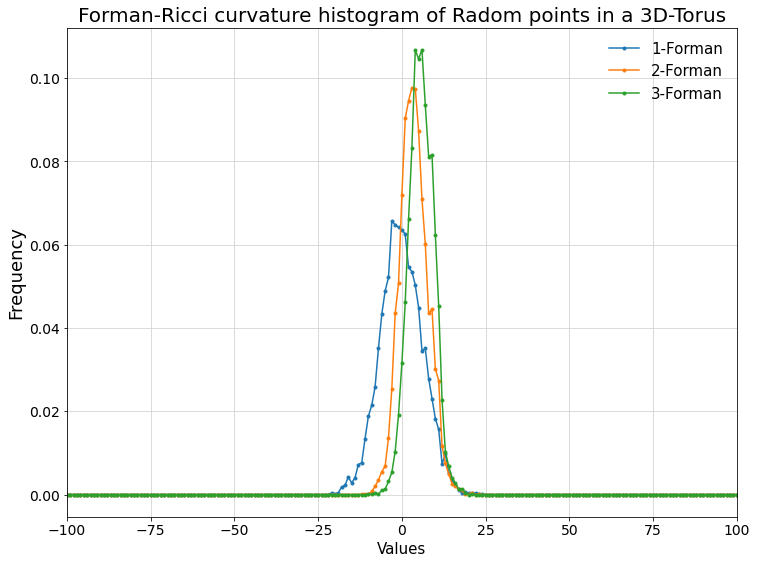

In [185]:
plt.figure(figsize=(12,9))
for d in Frec_Mobius.keys():
    Prob=np.array(list(Frec_Mobius[d].values()))
    Prob=Prob/sum(Prob)
    plt.plot(list(Frec_Mobius[d].keys()),Prob,marker=".",label=str(d)+"-Forman")
plt.legend(framealpha=0,fontsize=15)
plt.title("Forman-Ricci curvature histogram of Radom points in a 3D-Torus", fontsize=20)
plt.xlabel("Values",fontsize=15)
plt.ylabel("Frequency",fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(color="lightgray")
plt.xlim(-100,100)

Computing FRC for the cube:

In [75]:
Frec_Cube=ff.compute_FRC_frequency((Cube,Threshold),3)

(-100.0, 100.0)

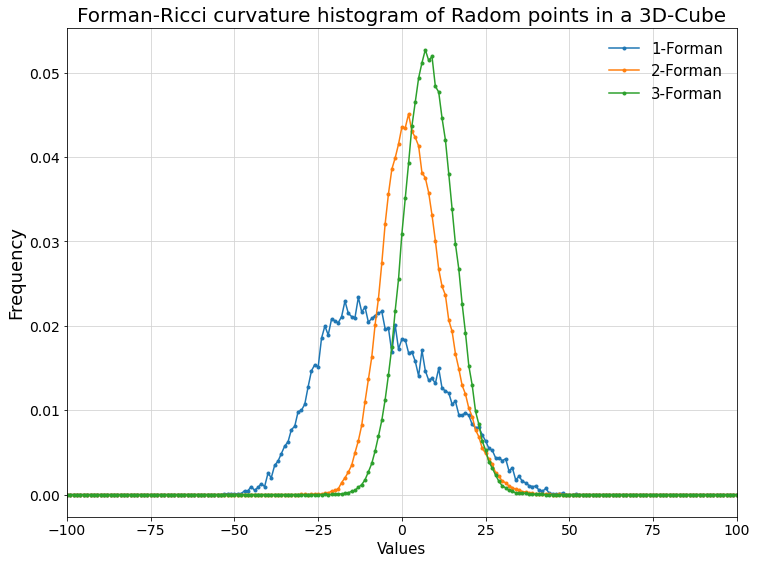

In [184]:
plt.figure(figsize=(12,9))
for d in Frec_Cube.keys():
    Prob=np.array(list(Frec_Cube[d].values()))
    Prob=Prob/sum(Prob)
    plt.plot(list(Frec_Cube[d].keys()),Prob,marker=".",label=str(d)+"-Forman")
plt.legend(framealpha=0,fontsize=15)
plt.title("Forman-Ricci curvature histogram of Radom points in a 3D-Cube", fontsize=20)
plt.xlabel("Values",fontsize=15)
plt.ylabel("Frequency",fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(color="lightgray")
plt.xlim(-100,100)

Plotting the results:

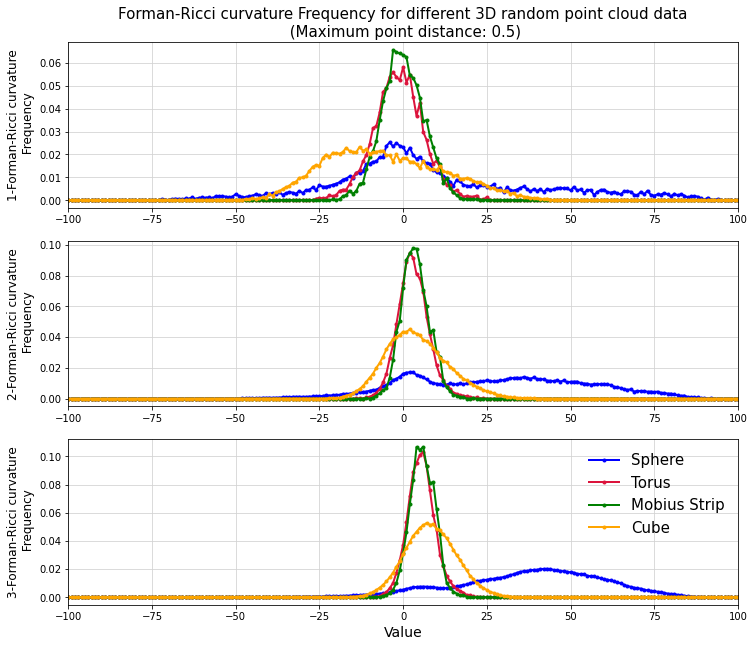

In [180]:
Frecs=[Frec_Sphere,Frec_Torus,Frec_Mobius,Frec_Cube]
Labels=["Sphere","Torus","Mobius Strip","Cube"]
Colors=["Blue","crimson","Green","orange"]

plt.figure(figsize=(12,14))
counter=0

for d in [1,2,3]:
    counter+=1
    c=-1
    plt.subplot(4,1,counter)
    if d==1:
        plt.title("Forman-Ricci curvature Frequency for different 3D random point cloud data\n (Maximum point distance: "+str(Threshold)+")",fontsize=15)
    plt.ylabel(str(d)+"-Forman-Ricci curvature\n Frequency",fontsize=12)
    for Frec in Frecs:
        c+=1
        Prob=np.array(list(Frec[d].values()))
        Prob=Prob/sum(Prob)
        plt.plot(list(Frec[d].keys()),Prob,marker=".",label=Labels[c],color=Colors[c],lw=2)
        plt.xlim(-100,100)
        plt.grid(color="lightgray")
plt.xlabel("Value",fontsize=14)       
plt.legend(framealpha=0,fontsize=15,loc="upper right")

# Analysis:

- It is expected that the Mobius stip and the torus has the same geometric features. This explains the similarity between the curves;
- Despite being topologically possible to deform a sphere into a cube, the geometric features clearly different throught a geometrical point of view;
- The quality of those curves increases with the curvature dimension.

# Example 2: Computing FRC from a network:

Here, we generate two random graphs with approximate edge density and compare the FRC computation:

In [14]:
import networkx as nx
import fastforman as ff

Generating random graph from Erdos-Renyi model:

In [6]:
ER=nx.erdos_renyi_graph(100,0.5)

In [7]:
nx.density(ER)

0.49454545454545457

Generateing random graph from random geometric model:

In [8]:
RG=nx.random_geometric_graph(100,0.67,dim=3)

In [9]:
nx.density(RG)

0.5014141414141414

Computing the average FRC, for max_dim=3:

In [10]:
Forman_ER=ff.compute_average_FRC(ER,3)

In [11]:
Forman_RG=ff.compute_average_FRC(RG,3)

Printing results:

In [12]:
Forman_ER

{1: -22.076363636363638, 2: -19.045145330859615, 3: -10.257954593271235}

In [13]:
Forman_RG

{1: -15.318181818181818, 2: -12.45987631416203, 3: -6.18303259823142}

Computing frequencies:

In [16]:
Frec_ER=ff.compute_FRC_frequency(ER,3)

In [17]:
Frec_RG=ff.compute_FRC_frequency(RG,3)

Plotting the results:

Text(0.5, 0, 'Value')

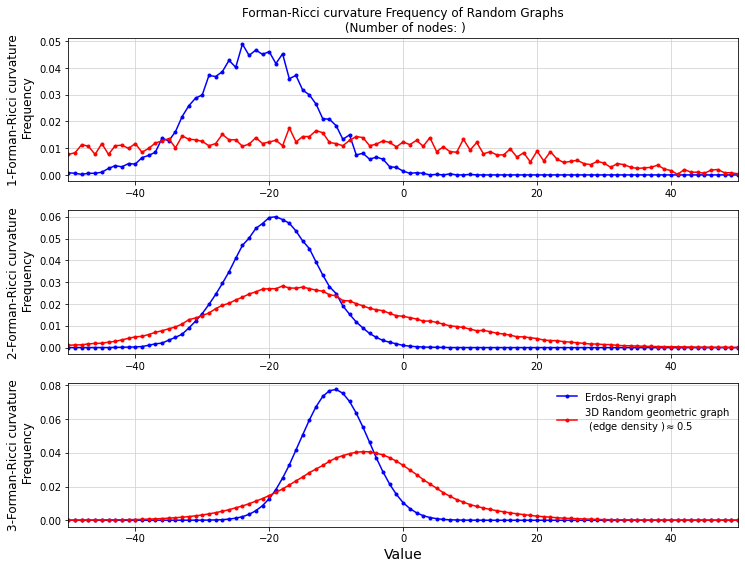

In [21]:

Frec=[Frec_ER,Frec_RG]
Labels=["Erdos-Renyi graph","3D Random geometric graph\n (edge density )"+r"$\approx 0.5$"]
Colors=["blue","red"]
plt.figure(figsize=(12,9))
c=0
for d in [1,2,3]:
    counter=-1
    c+=1
    for F in Frec:
        counter+=1
        
        plt.subplot(3,1,c)
        if d==1:
            plt.title("Forman-Ricci curvature Frequency of Random Graphs\n (Number of nodes: )")
       
        Prob=np.array(list(F[c].values()))
        Prob=Prob/sum(Prob)
        
        plt.plot(list(F[c].keys()),Prob,marker=".",label=Labels[counter],color=Colors[counter])
        plt.grid(color="lightgray")
        plt.ylabel(str(d)+"-Forman-Ricci curvature\n Frequency",fontsize=12)
        
        
        plt.xlim(-50,50)
    
plt.legend(framealpha=0)
plt.xlabel("Value",fontsize=14)       


## Analysis:

- Despite being random graphs, Erdos-Renyi model and Geometric graphs has different geometric features.